# Data 601 - Project
## Exploring the City of Calgary's Public Trees Dataset

Michael Ellsworth

Jennifer Leslie-Panek

Christy Sarmiento

### Introduction
- Trees are an asset to Calgarians as they improve community aesthetics, filter the air we breathe, capture carbon, prevent erosion and are homes for a variety of creatures.

- In Calgary, there are approximately 7 million trees within city limits.

- Calgary is an arid prairie type climate that is not necessarily conducive to growing trees.

- The challenge is that the majority of trees are publicly owned and hence the cost and maintenance of them fall on the municipality. Additionally, understanding the value of investing resources into trees is not particularly intuitive for citizens.

- The purpose of this project is to analyze the City of Calgary’s public tree data to present insight and understanding of Calgary’s public trees for greater understanding and support of this shared asset.

### Public Trees Dataset
- Public Trees
    - City of Calgary (2019) Public Trees [Online]. Available at: https://data.calgary.ca/Environment/Public-Trees/tfs4-3wwa (Accessed: 28 September 2019) 
- DECIDUOUS_EVERGREEN: A distinction of the type of tree, either "Deciduous" or "Evergreen"
- COMMON_NAME: The non-scientific name given for a tree
- GENUS: The first part in the binomial species name of a tree
- SPECIES: The second part in the binomial species name of a tree
- TREE_MAINTENANCE: The current general maintenance level provided to the tree based on tree stage of life
- DBH_CM: The diameter at breast height (approximately 1.4 m) of a tree in centimeters

### Public Trees Dataset
- MATURE_SIZE: The expected size of a tree at full maturity: small, medium or large
- RATING: Numberic value between 50-100
- TREE_CONDITION_RATING_PERC:  Percentage value between 0-100 assigned by trained Urban Forestry staff
- COMM_CODE: The short-hand code used to identify the community an asset resides in
- longitude: The longitude of the tree
- latitude: The latitude of the tree
- location: A column with the combined longitude and latitude of the tree

### Community Dataset
- Community Points
    - City of Calgary (2019) Community Points [Online]. Available at: https://data.calgary.ca/Base-Maps/Community-Points/j9ps-fyst (Accessed: 28 September 2019)
- Census by Community 2019
    - City of Calgary (2019) Census by Community 2019 [Online]. Available at: https://data.calgary.ca/Demographics/Census-by-Community-2019/rkfr-buzb (Accessed: 28 September 2019)
- CLASS: Community class definition: 'Residential', 'Industrial', 'Major Park', 'Residual Sub Area'
- COMM_CODE: Community identifier used to merge with tree dataset

### Community Dataset
- NAME: The name of the community
- SECTOR: The sector in which the community is in
- longitude: The longitude of the centroid of the community
- latitude: The latitude of the centroid of the community
- location: A column with the combined longitude and latitude of the centroid of the community

### Guiding Questions

#### Data Cleaning
- Are there noticeable gaps in the data? 
- Is there anything about the missing data that would help provide context for further analysis?

#### Tree Maintenance and Condition
- Do certain types of species require more maintenance? 
- Does size affect the condition of trees? 

#### Visualizing Tree Density
- What does the general tree density look like across the city? 
- Is it apparent where the highest density of good condition trees resides? 

#### Quantifying Tree Value
- How much value does each tree provide? 
- What is the density of the value in each community? 

# Packages
- Pandas
- Numpy
- Matplotlib
- Plotly
- Plotly Express
- Geopandas

In [1]:
# Load packages
import pandas as pd
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('ggplot')

import plotly.graph_objs as go

import plotly.express as px

import geopandas as gpd

In [2]:
# Import Public Tree data and Community Points data
public_trees_raw = pd.read_csv("./Public_Trees.csv")
community_info_raw = pd.read_csv("./Community_Points.csv")
community_info_raw.rename(columns={'longitude':'LONGITUDE_CTR','latitude':'LATITUDE_CTR','location':'LOC_CTR'}, inplace=True)

# Join dataframes
public_trees = pd.merge(public_trees_raw, community_info_raw, on='COMM_CODE', how='left')

## Clean data and drop columns

# Change all columns (features) to upper case
public_trees.columns = map(lambda x: str(x).upper(), public_trees.columns)

# Change all rows (observations) to upper case
public_trees_cleaned = public_trees.apply(lambda x: x.astype(str).str.upper())

# Drop columns that are not needed in the analysis
public_trees_cleaned = public_trees_cleaned.drop(['ASSET_TYPE',
                                                  'HORT_CODE',
                                                  'CULTIVAR',
                                                  'TREE_ASSET_CD',
                                                  'CLASS_CODE',
                                                  'LONGITUDE_CTR',
                                                  'LATITUDE_CTR',
                                                  'LOC_CTR'],
                                                 axis = 1)

### Data Cleaning
- Removed unnecessary columns
- Converted all text data to upper case
- Merged datasets together
- Explored data and removed non-existing trees (stumps)

In [3]:
# Based on the values in the TREE_MAINTENANCE column, there may be some trees that are no longer trees
display(public_trees_cleaned.TREE_MAINTENANCE.unique())

# Remove stumps from the dataset in order to limit the data to living trees
public_trees_no_stumps = public_trees_cleaned[
    ~public_trees_cleaned['TREE_MAINTENANCE'].isin(['STUMP REMOVAL', # The "~" infront of public_trees_cleaned filters
                                                                     # the stumps out of the dataframe. If this 
                                                                     # was not included, only the stumps would remain
                                                                     # in the dataframe
                                                   'REMOVE STUMP'])
]

array(['MAINTAIN TREE', 'MAINTAIN SHRUB', 'ESTABLISH TREE', 'NAN',
       'PLANT SITE', 'STUMP REMOVAL', 'REMOVE STUMP'], dtype=object)

### Tree Maintenance
- Started by getting a sense of what level of detail is available
- Determined that trees were classified primarily by "Maintain" or "Establish"
- Maintain = less maintenance
- Establish = more maintenance
- This served as a valuable distinction between trees that required and didn't require maintenance

In [4]:
# In order to get a sense of the level of maintenance that is required for Calgary trees,
# we can create a bar graph with the counts of each maintenance level

# Start out by excluding all other columns to just capture the maintenance information in a Pandas Series
maintenance_groups = public_trees_no_stumps['TREE_MAINTENANCE']

# Drop "NAN" values from the series
maintenance_groups_cleaned = maintenance_groups[maintenance_groups != "NAN"]

# Use the "value_counts" function to count the unique values in the newly created column
maintenance_counts = pd.DataFrame(maintenance_groups_cleaned.value_counts()).reset_index()
maintenance_counts = maintenance_counts.rename(columns = {"index": "TREE_MAINTENANCE",
                                                          "TREE_MAINTENANCE": "COUNT"})

# Create a bar chart to visualize the counts in each category
maintenance_counts_bar_plot = px.bar(maintenance_counts, x='TREE_MAINTENANCE', y='COUNT')

In [5]:
maintenance_counts_bar_plot.show()

### Tree Maintenance
- Based on the limited trees classified as "Maintain Shrub" or "Plant Site", we excluded these classifications in our analysis
- This decision was made prior to Leanne's lecture on Ethics and Privacy

In [6]:
# Since it's unclear what the MAINTAIN SHRUB and PLANT SITE amounts are, we can plot these separately

# Drop "NAN", "MAINTAIN TREE" and "ESTABLISH TREE" values from the series
maintenance_groups_small = maintenance_groups[~maintenance_groups.isin(['NAN',
                                                                        'MAINTAIN TREE',
                                                                        'ESTABLISH TREE'])]
maintenance_groups_small_counts = pd.DataFrame(maintenance_groups_small.value_counts()).reset_index()
maintenance_groups_small_counts = maintenance_groups_small_counts.rename(columns = {"index": "TREE_MAINTENANCE",
                                                                                    "TREE_MAINTENANCE": "COUNT"})
maintenance_groups_small_counts_plot = px.bar(maintenance_groups_small_counts, x='TREE_MAINTENANCE', y='COUNT')

In [7]:
maintenance_groups_small_counts_plot.show()

In [8]:
# Since there is a relatively small amount of maintenance level data from "MAINTAIN SHRUB"
# and "PLANT SITE", we will drop these from further analysis

public_trees_for_maintenance = public_trees_no_stumps[
    ~public_trees_no_stumps[['TREE_MAINTENANCE', 'SPECIES']].isin(['NAN','MAINTAIN SHRUB','PLANT SITE'])]

### Tree Maintenance
- Next step:
    - Explore maintenance requirements for differenet Species types
    - Determine which Species require the most maintenance in terms of:
        - Total counts
        - Proportions

In [9]:
#########################################################################
#                                                                       #
#    Explore how maintenance level changes based on the Species type    #
#                                                                       #
#########################################################################

# Take the "TREE_MAINTENANCE" and "SPECIES" column from our cleaned dataset
maintenance_by_species = public_trees_for_maintenance[['TREE_MAINTENANCE', 'SPECIES']]

## TOTAL COUNTS
# Group the data by "SPECIES" and obtain counts for trees that do and do not require maintenance
maintenance_by_species_counts = pd.DataFrame(maintenance_by_species.groupby('SPECIES').TREE_MAINTENANCE.value_counts())

# Change the new column we created to "MAINTAIN COUNT"
maintenance_by_species_counts = maintenance_by_species_counts.rename(columns = {"TREE_MAINTENANCE": "MAINTAIN COUNT"})

# Reset the index in order to use in future plots
maintenance_by_species_counts = maintenance_by_species_counts.reset_index()

## PROPORTION
# Group the data by "SPECIES" and obtain the proportion of trees that do and do not require maintenance
maintenance_by_species_proportions = pd.DataFrame(maintenance_by_species.groupby('SPECIES').TREE_MAINTENANCE.value_counts(normalize = True))

# Change the new column we created to "MAINTAIN PROPORTION"
maintenance_by_species_proportions = maintenance_by_species_proportions.rename(columns = {"TREE_MAINTENANCE": "MAINTAIN PROPORTION"})

# Reset the index in order to use in future plots
maintenance_by_species_proportions = maintenance_by_species_proportions.reset_index()

In [10]:
#################################################################
#                                                               #
#    Plot the TOTAL COUNTS for MAINTAIN TREE per SPECIES type   #
#                                                               #
#################################################################

# Filter the "TREE_MAINTENANCE" column to include only trees classified as "MAINTAIN TREE"
species_maintenance_counts_plot = maintenance_by_species_counts[maintenance_by_species_counts['TREE_MAINTENANCE'] == 'MAINTAIN TREE']

# Sort the count values so that they are in descending order
species_maintenance_counts_plot = species_maintenance_counts_plot.sort_values(by = 'MAINTAIN COUNT', ascending = False)

# Use plotly express to create a bar chart to visualize the data
maintenance_counts_by_species_plot = px.bar(species_maintenance_counts_plot, x='SPECIES', y='MAINTAIN COUNT')

In [11]:
maintenance_counts_by_species_plot.show()

In [12]:
####################################################################################
#                                                                                  #
#    Plot the TOTAL COUNTS for MAINTAIN TREE per SPECIES type for counts > 10,000  #
#                                                                                  #
####################################################################################

# Filter the maintenance counts to include only values greater than 10,000
species_maintenance_counts_plot2 = species_maintenance_counts_plot[species_maintenance_counts_plot['MAINTAIN COUNT'] > 10000]

# Use plotly express to create a bar chart to visualize the data
maint_counts_species_top_plot = px.bar(species_maintenance_counts_plot2, x='SPECIES', y='MAINTAIN COUNT')

In [13]:
maint_counts_species_top_plot.show()

In [14]:
#####################################################################################
#                                                                                   #
#    Plot the TOTAL COUNTS for ESTABLISH TREE per SPECIES type for counts > 10,000  #
#                                                                                   #
#####################################################################################

# Filter the "TREE_MAINTENANCE" column to include only trees classified as "ESTABLISH TREE"
species_establish_counts_plot = maintenance_by_species_counts[maintenance_by_species_counts['TREE_MAINTENANCE'] == 'ESTABLISH TREE']

# Sort the count values so that they are in descending order
species_establish_counts_plot = species_establish_counts_plot.sort_values(by = 'MAINTAIN COUNT', ascending = False)

# Filter the maintenance counts to include only values greater than 10,000
species_establish_counts_plot = species_establish_counts_plot[species_establish_counts_plot['MAINTAIN COUNT'] > 10000]

# Use plotly express to create a bar chart to visualize the data
establish_counts_species_top_plot = px.bar(species_establish_counts_plot, x='SPECIES', y='MAINTAIN COUNT')

In [15]:
establish_counts_species_top_plot.show()

### Tree Maintenance
- Although Pungens is the species type that has the highest count of trees requiring no maintenance and Americana is the species type that has the highest count of trees that require maintenance, these numbers are skewed based on total tree counts
- It is difficult to conclude whether these trees need or do not need a lot of maintenance

### Tree Maintenance
- In order to normalize the data based on tree counts, each species type was compared based on maintenance proportion

In [16]:
##########################################################################
#                                                                        #
#    Plot the PROPORTIONS for MAINTAIN/ESTABLISH TREE per SPECIES type   #
#                                                                        #
##########################################################################

# Sort the proportion values so that they are in descending order
maintenance_by_species_proportions_plot = maintenance_by_species_proportions.sort_values(by = 'MAINTAIN PROPORTION', ascending = False)

# Use plotly express to create a bar chart to visualize the data
maint_species_prop_plot = px.bar(maintenance_by_species_proportions_plot, x='SPECIES', y='MAINTAIN PROPORTION', color='TREE_MAINTENANCE')

In [17]:
maint_species_prop_plot.show()

In [18]:
# Create a top 10 list of trees by Species type

# value_counts() creates an ordered list (descending) which we can pull the first 10 values from
maintenance_by_species_top10 = maintenance_by_species.SPECIES.value_counts()[0:10]

# Create a list
species_top_10_list = list(pd.DataFrame(maintenance_by_species_top10).index)

In [19]:
#################################################################################
#                                                                               #
#    Plot the PROPORTIONS for MAINTAIN/ESTABLISH TREE for top 10 SPECIES type   #
#                                                                               #
#################################################################################

# Filter the Species to include only the top 10 Species in Calgary by count
maintenance_by_species_proportions_plot2 = maintenance_by_species_proportions[
    maintenance_by_species_proportions['SPECIES'].isin(species_top_10_list)]

# Sort the proportion values so that they are in descending order
maintenance_by_species_proportions_plot2 = maintenance_by_species_proportions_plot2.sort_values(by = 'MAINTAIN PROPORTION', ascending = False)

# Use plotly express to create a bar chart to visualize the data
maint_species_prop_top_10_plot = px.bar(maintenance_by_species_proportions_plot2, x='SPECIES', y='MAINTAIN PROPORTION', color='TREE_MAINTENANCE')

In [20]:
maint_species_prop_top_10_plot.show()

### Tree Maintenance
- Of the top 10 Species types in Calgary, Jackii appear to require the least maintenance while Macrocarpa require the most
- Of the top 10 Species types in Calgary, the ones requiring the most maintenance tend to be deciduous trees
    - Should Calgary focus on planting less deciduous trees as they require more maintenance?

### Tree Condition
- Although the Tree Maintenance data has uncovered some interesting trends, there are only two types of observations available
    - Maintain tree
    - Establish tree
- Tree condition appears to be a more descriptive statistic for evaluating how much maintenance would be required on a tree
    - If tree condition is lower, tree maintenance would intuitively be higher
- Tree condition ranges between 0 and 100
- This condition is determined by Urban Forestry staff
- In this analysis, we will attempt to see how different variables affect Tree Condition
    - Species type
    - Mature size
    - Tree density

In [21]:
#########################################################################
#                                                                       #
#    Plot the Average Tree Condition per Species type (Top 10 Species)  #
#                                                                       #
#########################################################################

# From the public trees dataset, create a new dataframe with only Tree Condition and Species
condition_by_species = public_trees_no_stumps[['TREE_CONDITION_RATING_PERC', 'SPECIES']]

# Filter NANs from Tree Condition column
condition_by_species = condition_by_species[~condition_by_species['TREE_CONDITION_RATING_PERC'].isin(['NAN'])]

# Filter for Top 10 Species in Calgary using list created earlier
condition_by_species = condition_by_species[condition_by_species['SPECIES'].isin(species_top_10_list)]

# Ensure Tree Condition column is numeric
condition_by_species['TREE_CONDITION_RATING_PERC'] = pd.to_numeric(condition_by_species['TREE_CONDITION_RATING_PERC'])

# Filter out any 0 values and values over 100
condition_by_species = condition_by_species[condition_by_species['TREE_CONDITION_RATING_PERC'] <= 100]
condition_by_species = condition_by_species[condition_by_species['TREE_CONDITION_RATING_PERC'] > 0]

# Group by Species type and find the mean tree condition per Species type. Sort the values in descending order
condition_by_species_means = condition_by_species.groupby(['SPECIES']).mean().sort_values(by = 'TREE_CONDITION_RATING_PERC', ascending = False)

# Rename the Tree Condition column
condition_by_species_means = condition_by_species_means.rename(columns = {"TREE_CONDITION_RATING_PERC": "AVERAGE TREE CONDITION"})

# Reset the index of the Grouped DataFrame in order to make plotting easier
condition_by_species_means = condition_by_species_means.reset_index()

# Use plotly express to create a bar chart to visualize the data
condition_by_species_means_bar = px.bar(condition_by_species_means, x='SPECIES', y='AVERAGE TREE CONDITION')

In [22]:
condition_by_species_means_bar.show()

### Tree Condition
- Of the top 10 Species types, Tremula appears to have the best average condition
    - Based on the the Tree Maintenance data, this Species of tree also does not regularly require maintenance
    - This tree species is a deciduous tree
    - This tree appears to be a good pick for future tree planting in Calgary
- Of the top 10 Species types, Padus appears to have the worst average condition
- Jackii also has relatively poor condition which is consistent with the Tree maintenance data presented above
    - This tree species is a coniferous tree
    - Jackii may not be a good pick for future tree planting in Calgary

In [23]:
# Use plotly express to create a box plot to visualize the data
condition_by_species_box = px.box(condition_by_species, x="SPECIES", y="TREE_CONDITION_RATING_PERC", points = False)

In [24]:
condition_by_species_box.show()

### Tree Condition
- Although we have determined the best condition trees in Calgary, we can see based on the boxplot that the difference in average tree condition is quite small
- Although the variation in the data isn't as wide, the tree maintenance data was potentially more useful for this type of analysis

### Tree Condition
- The next step in this analysis is to determine if tree size has a considerable impact on tree condition
- Is it clear whether Calgary should plant fewer of a specific type of tree?

In [25]:
#########################################################
#                                                       #
#    Plot the Average Tree Condition per Tree size      #
#                                                       #
#########################################################

# From the public trees dataset, create a new dataframe with only Tree Condition and Mature Size
condition_by_size = public_trees_no_stumps[['TREE_CONDITION_RATING_PERC', 'MATURE_SIZE']]

# Filter NANs in Tree Condition and Mature Size columns. Also, remove Shrubs from Mature Size column
condition_by_size = condition_by_size[
    ~condition_by_size[['TREE_CONDITION_RATING_PERC', 'MATURE_SIZE']].isin(['NAN', 'SHRUB'])]

# Ensure Tree Condition column is numeric
condition_by_size['TREE_CONDITION_RATING_PERC'] = pd.to_numeric(condition_by_size['TREE_CONDITION_RATING_PERC'])

# Filter out any tree condition 0 values and values over 100
condition_by_size = condition_by_size[condition_by_size['TREE_CONDITION_RATING_PERC'] <= 100]
condition_by_size = condition_by_size[condition_by_size['TREE_CONDITION_RATING_PERC'] > 0]

# Group by Mature Size and find the mean tree condition per size. Sort the values in descending order
condition_by_size_means = condition_by_size.groupby(['MATURE_SIZE']).mean().sort_values(by = 'TREE_CONDITION_RATING_PERC', ascending = False)

# Rename the Tree Condition column
condition_by_size_means = condition_by_size_means.rename(columns = {"TREE_CONDITION_RATING_PERC": "AVERAGE TREE CONDITION"})

# Reset the index of the Grouped DataFrame in order to make plotting easier
condition_by_size_means = condition_by_size_means.reset_index()

# Use plotly express to create a bar chart to visualize the data
condition_by_size_means_bar = px.bar(condition_by_size_means, x='MATURE_SIZE', y='AVERAGE TREE CONDITION')

# Use plotly express to create a box plot to visualize the data
condition_by_size_box = px.box(condition_by_size, x="MATURE_SIZE", y="TREE_CONDITION_RATING_PERC", points = False)

In [26]:
condition_by_size_means_bar.show()

### Tree Condition
- Based on the above chart, we can see that smaller trees have a better tree condition on average than other trees
- This difference is quite small though and requires zooming in on plotly to see the differences

In [27]:
condition_by_size_box.show()

### Tree Condition
- This difference in average tree condition is apparent in the boxplot above
- There are only subtle differences in the tree condition of different sizes of trees

### Tree Maintenance and Condition

Summary:

- Based on the tree maintenance and tree condition data, deciduous trees tend to be in better condition than coniferous trees but they require more maintenance
    - The best trees based on average tree condition were mostly deciduous trees
    - The trees with a requiring more maintenance were mostly deciduous trees
- There does not appear to be any significant difference between the size of trees and tree condition
    - Although small trees had the best average condition, the differences between the average tree condition was very small

### Tree Density
- The next section aims to determine where the highest tree density in Calgary is
- Based on tree count and area of each community, density was calculated
- From there, we could sort to find the highest tree density communtiies

In [28]:
############################################
#                                          #
#    Plot the Tree Density per Community   #
#                                          #
############################################

# Load in the Community Area data (area of communities in km2)
comm_area = pd.read_csv("City_of_Calgary_Community_Areas.csv")

# Change case of column names to upper case
comm_area.columns = map(lambda x: str(x).upper(), comm_area.columns)

# Drop unnecessary columns from Community Areas Data Frame
comm_area = comm_area.drop(['FID',
                            'SHAPE',
                            'CLASS',
                            'CLASS_CODE',
                            'COMM_STRUC', 
                            'NAME',
                            'SECTOR',
                            'SRG'],
                            axis = 1)

## NEW DATA FRAME FOR TREE COUNTS PER COMMUNITY
# Create a Data Frame of public tree counts by community (grouping by "COMM_CODE")
public_trees_counts = pd.DataFrame(public_trees_cleaned.groupby(['COMM_CODE']).NAME.value_counts())

# Rename newly created column to TREE COUNT
public_trees_counts = public_trees_counts.rename(columns = {"NAME": "TREE COUNT"})

# Reset index to make plotting and merging easier
public_trees_counts = public_trees_counts.reset_index()

# Merge the Data Frame of Tree Counts and the Data Frame of Community Areas
public_trees_by_comm = pd.merge(public_trees_counts, comm_area, on='COMM_CODE', how='left')

# Calculate Tree Density column by dividing TREE COUNT and Community Area (km2). Sort in descending order
public_trees_by_comm['DENSITY'] = round((public_trees_by_comm['TREE COUNT']/public_trees_by_comm['AREA_SQ_M'])*10000,2)
public_trees_by_comm = public_trees_by_comm.sort_values(by = 'DENSITY', ascending = False)

# Use plotly express to create a bar chart to visualize the data (top 10 communities by density)
comm_tree_density_plot = px.bar(public_trees_by_comm[0:10], x='NAME', y='DENSITY') # Select only the top 10

In [29]:
comm_tree_density_plot.show()

### Tree Density
- Based on the visualization above, Queens Park Village has the highest tree density in Calgary
- It also seems like a lot of inner city communities have the highest tree density - is this clear on a map?

### Tree Density
- Next, we wanted to determine if there was a reason why the tree density was so high in these communities
- Is there any correlation between tree condition and tree density?

In [30]:
####################################################################################
#                                                                                  #
#    Create new Data Frame for average tree condition and diameter per community   #
#                                                                                  #
####################################################################################

### NEW DATA FRAME FOR AVERAGE TREE CONDITION PER COMMUNITY

# Select tree condition and community code columns
public_trees_means = public_trees_cleaned[['TREE_CONDITION_RATING_PERC', 'COMM_CODE']]

# Drop NANs
public_trees_means = public_trees_means[~public_trees_means['TREE_CONDITION_RATING_PERC'].isin(['NAN'])]

# Convert to numeric
public_trees_means['TREE_CONDITION_RATING_PERC'] = pd.to_numeric(public_trees_means['TREE_CONDITION_RATING_PERC'])

# Create a Data Frame of public tree condition by community (grouping by "COMM_CODE")
public_trees_means = pd.DataFrame(public_trees_means.groupby(['COMM_CODE']).mean())

# Rename newly created column to TREE MEAN
public_trees_means = public_trees_means.rename(columns = {"TREE_CONDITION_RATING_PERC": "AVERAGE TREE CONDITION"})

# Reset index to make plotting and merging easier
public_trees_means = public_trees_means.reset_index()

### NEW DATA FRAME FOR AVERAGE TREE DIAMETER PER COMMUNITY

# Select tree diameter and community code columns
public_trees_diameters = public_trees_cleaned[['DBH_CM', 'COMM_CODE']]

# Drop NANs
public_trees_diameters = public_trees_diameters[~public_trees_diameters['DBH_CM'].isin(['NAN'])]

# Convert to numeric
public_trees_diameters['DBH_CM'] = pd.to_numeric(public_trees_diameters['DBH_CM'])

# Create a Data Frame of public tree condition by community (grouping by "COMM_CODE")
public_trees_diameters = pd.DataFrame(public_trees_diameters.groupby(['COMM_CODE']).mean())

# Rename newly created column to TREE DIAMETER
public_trees_diameters = public_trees_diameters.rename(columns = {"DBH_CM": "TREE DIAMETER"})

# Reset index to make plotting and merging easier
public_trees_diameters = public_trees_diameters.reset_index()

# Merge all Data Frames (Count, Density, Average Condition, Diameter)
public_tree_stats_by_comm = pd.merge(public_trees_by_comm, public_trees_means, on='COMM_CODE', how='left')
public_tree_stats_by_comm_all = pd.merge(public_tree_stats_by_comm, public_trees_diameters, on='COMM_CODE', how='left')

In [31]:
#########################################################
#                                                       #
#    Plot the Average Tree Condition by Tree Density    #
#                                                       #
#########################################################

density_top_10 = public_trees_by_comm[0:10]['NAME']
density_top_10_list = list(density_top_10)
display(density_top_10_list)

public_tree_stats_top_10 = public_tree_stats_by_comm_all[public_tree_stats_by_comm_all['NAME'].isin(density_top_10_list)]
public_tree_stats_plot = px.bar(public_tree_stats_top_10, x='NAME', y='AVERAGE TREE CONDITION', color = 'DENSITY',
                                color_continuous_scale = 'Greens',
                                range_color = [0, 60])

['QUEENS PARK VILLAGE',
 'EAU CLAIRE',
 'ERLTON',
 'GARRISON GREEN',
 'ROSEDALE',
 'SCARBORO',
 'ROXBORO',
 'SUNNYSIDE',
 'DOWNTOWN WEST END',
 'CHARLESWOOD']

In [32]:
public_tree_stats_plot.show()

### Tree Density
- Based on the plot above, Roxboro is the community with the best tree condition out of the communities with the highest density of trees
- There doesn't appear to be a clear correlation between tree density and tree condition though - tree condition is quite variable amongst these communities

### Tree Density
- The next step was to determine the best way to visualize this data on a map
    - Tested three classification types:
        - Equal interval
        - Fisher jenks
        - Quartiles
- From there, we could visualize tree density per community to determine where the highest tree density communities are relative to each other
- Tree count and tree density are not very useful variables on their own as they do not say anything about the tree itself, except for location.  It's best to combine these data with other vairiables such as tree condition and tree diameter.
- Hence, we can create an interactive map that has all of this data available

In [33]:
##############################################################
#                                                            #
#    Plot the Tree Density in a Choropleth Map of Calgary    #
#                                                            #
##############################################################

# Load in the 2019 Census geojson file
census_file = './Census by Community 2019.geojson'
census_gpd = gpd.read_file(census_file)

# Change case of column names to upper case
census_gpd.columns = map(lambda x: str(x).upper(), census_gpd.columns)

# Select "NAME" and "GEOMETRY" columns for merging with other Data Frames
census_gpd = census_gpd[['NAME', 'GEOMETRY']]

# Filter out rows with 0 values
public_tree_stats_by_comm_all = public_tree_stats_by_comm_all[public_tree_stats_by_comm_all['DENSITY'] > 0]
public_tree_stats_by_comm_all = public_tree_stats_by_comm_all[public_tree_stats_by_comm_all['AVERAGE TREE CONDITION'] > 0]
public_tree_stats_by_comm_all = public_tree_stats_by_comm_all[public_tree_stats_by_comm_all['TREE DIAMETER'] > 0]

# Merge geopandas dataframe with stats by community data frame
density_map = pd.merge(public_tree_stats_by_comm_all, census_gpd, on='NAME', how='left')
density_map.set_index('NAME', inplace=True)

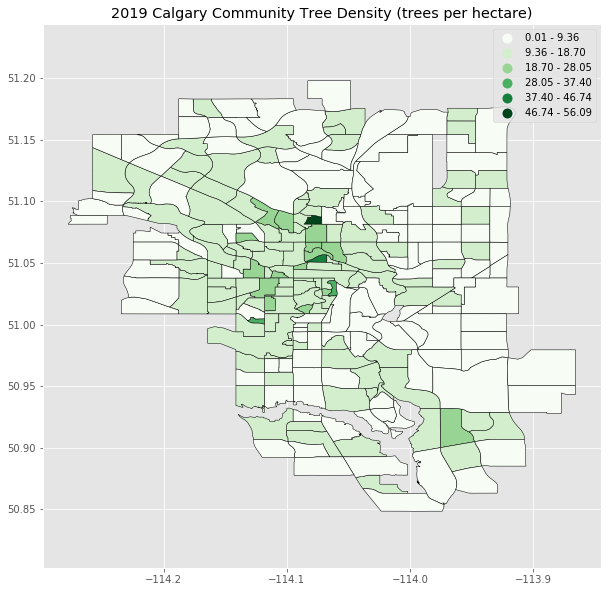

In [34]:
crs = {'init': 'epsg:3395'}
density_map = gpd.GeoDataFrame(density_map, crs = crs, geometry = 'GEOMETRY')
fig = plt.figure()
axis = fig.add_subplot(1,1,1)
# Create Choropleth Map of Calgary by Density (Equal Interval)
density_map_plot_EI = density_map.plot(ax = axis, column='DENSITY',scheme='equal_interval',
                                    k=6,cmap='Greens',legend=True,edgecolor = 'black') 
plt.axis('equal')
plt.title('2019 Calgary Community Tree Density (trees per hectare)')
fig.set_size_inches(10,10)

### Tree Density
- The above plot doesn't appear to clearly show areas of higher density trees
- Equal interval does not seem like the best classification type for this map

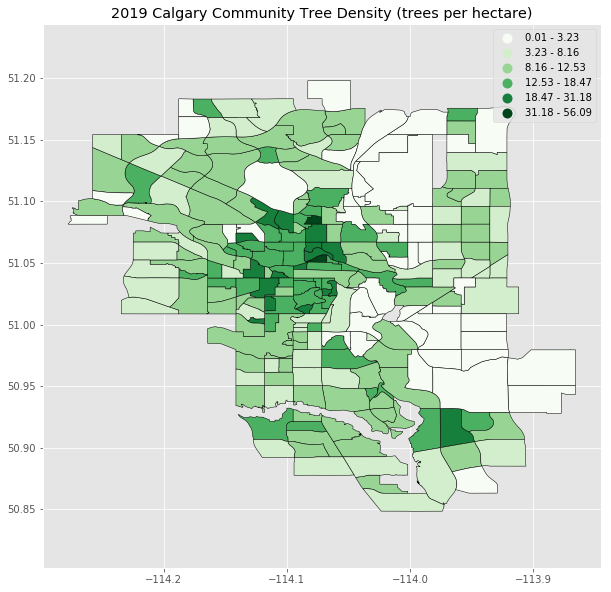

In [35]:
fig = plt.figure()
axis = fig.add_subplot(1,1,1)
# Create Choropleth Map of Calgary by Density (Fisher Jenks)
density_map_plot_FJ = density_map.plot(ax = axis, column='DENSITY', scheme='fisher_jenks',
                                    k=6, cmap='Greens', legend=True, edgecolor = 'black') 
plt.axis('equal')
plt.title('2019 Calgary Community Tree Density (trees per hectare)')
fig.set_size_inches(10,10)

### Tree Density
- The above plot is an improvement over the previous plot but still isn't completely clear
- Fisher jenks does not seem like the best classification type for this map

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



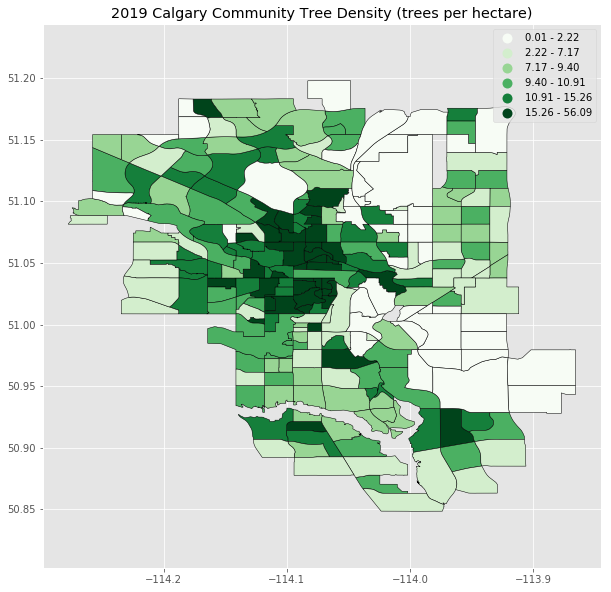

In [36]:
fig = plt.figure()
axis = fig.add_subplot(1,1,1)
# Create Choropleth Map of Calgary by Density (Quantiles)
density_map_plot_Q = density_map.plot(ax = axis, column='DENSITY', scheme='quantiles',
                                    k=6, cmap='Greens', legend=True, edgecolor = 'black') 
plt.axis('equal')
plt.title('2019 Calgary Community Tree Density (trees per hectare)')
fig.set_size_inches(10,10)

### Tree Density
- The above plot is a clear improvement over the previous plots
- Quantiles seems like the best classification type for this map and will be used for further analysis
- Additionally, from this map we can see that tree density appears to be highest in the inner city communities
    - This is consistent with our analysis of the 10 most tree dense communities

### Tree Density
- Now that we have an understanding where the most tree dense communities are, are there any consistencies with other features in the Public Trees dataset?
- We can answer this question using the same maps but plotting different variables
    - Tree Count
    - Tree Condition
    - Tree Diameter

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



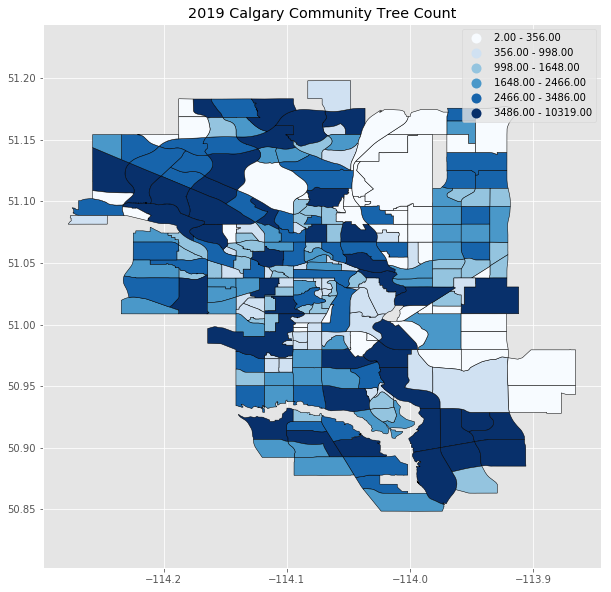

In [37]:
fig = plt.figure()
axis = fig.add_subplot(1,1,1)
# Create Choropleth Map of Calgary by Tree Count
tree_count_map_plot = density_map.plot(ax = axis, column='TREE COUNT', scheme='quantiles',
                                    k=6, cmap='Blues', legend=True, edgecolor = 'black') 
plt.axis('equal')
plt.title('2019 Calgary Community Tree Count')
fig.set_size_inches(10,10)

### Tree Density
- Based on the map above, we can see that the highest tree counts are in NW and SE communities which have larger community areas
- This is not consistent with our tree density map but this is likely more a function of community size than tree count

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



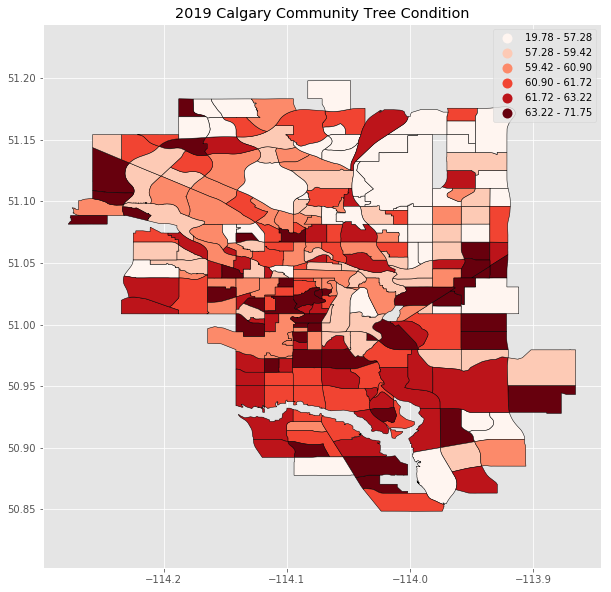

In [38]:
fig = plt.figure()
axis = fig.add_subplot(1,1,1)
# Create Choropleth Map of Calgary by Average Tree Condition
tree_condition_map_plot = density_map.plot(ax = axis, column='AVERAGE TREE CONDITION', scheme='quantiles',
                                    k=6, cmap='Reds', legend=True, edgecolor = 'black') 
plt.axis('equal')
plt.title('2019 Calgary Community Tree Condition')
fig.set_size_inches(10,10)

### Tree Density
- Based on the map above, it doesn't appear as though there are any regions with clear tree condition differences than others
- Tree condition is fairly variable across the city but there are some communities in the south that appear to have better tree condition.  This could be due to more favorable weather conditions in the south than the north.
- This is consistent with the analysis on tree condition versus tree density
    - The communities in the inner city tended to have variable tree condition with no apparent correlation between tree condition and tree density

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



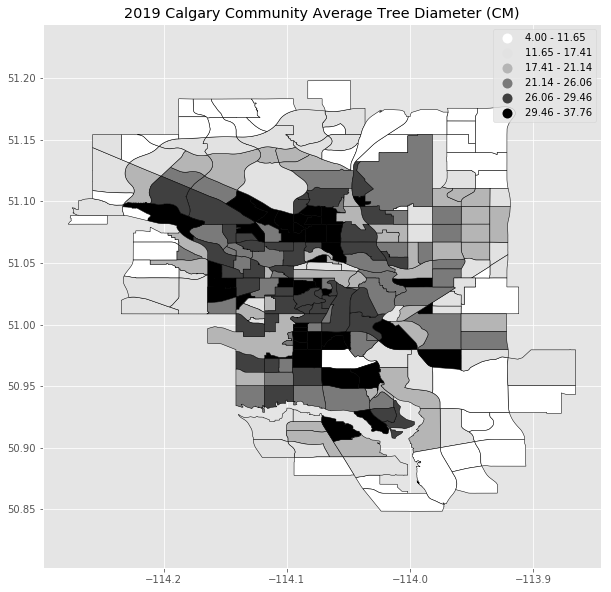

In [39]:
fig = plt.figure()
axis = fig.add_subplot(1,1,1)
# Create Choropleth Map of Calgary by Average Tree Diameter
tree_diameter_map_plot = density_map.plot(ax = axis, column='TREE DIAMETER', scheme='quantiles',
                                    k=6, cmap='Greys', legend=True, edgecolor = 'black') 
plt.axis('equal')
plt.title('2019 Calgary Community Average Tree Diameter (CM)')
fig.set_size_inches(10,10)

### Tree Density
- Based on the map above, the largest trees are in the inner city, in the older and more established communities
- These are also the areas with the highest tree density

In [40]:
community_lat_lon = community_info_raw[['NAME', 'LONGITUDE_CTR', 'LATITUDE_CTR']]
public_trees_plotly = pd.merge(public_tree_stats_by_comm_all, community_lat_lon, on = 'NAME')

px.set_mapbox_access_token('pk.eyJ1IjoibWllbGxzd29ydGgiLCJhIjoiY2sxOXh2M3A5MDJhcjNtcWRhaG9hOW1lcyJ9.ucvS3juZz9j_XSHQyzB5Eg')

tree_stats_plot = px.scatter_mapbox(public_trees_plotly,
                        lat="LATITUDE_CTR",
                        lon="LONGITUDE_CTR",
                        color="DENSITY",
                        size="TREE COUNT",
                        hover_data=['NAME', 'TREE DIAMETER', 'AVERAGE TREE CONDITION'],
                        color_continuous_scale=px.colors.sequential.Plasma[::-1],
                        size_max=15,
                        zoom=9)

tree_stats_plot = tree_stats_plot.update_layout(title_text = '2019 YYC Tree Stats per community')

In [41]:
tree_stats_plot.show()

### Tree Density

Summary:

- Highest tree density in the inner city - smaller community areas
- Highest tree counts in the NW and SE residential areas - larger community areas
- Higher tree condition values toward the south
- Inner city communities have older and bigger diameter trees

### Carbon Capture - Tree Value Assessment
* In order to determine the value of trees, we assessed the carbon captured of each tree in Calgary

* Most part of this project was spent in research for the appropriate method to utilize based on the chosen dataset. 

* Paper that evaluates four methods in the estimation of carbon sequestration.[https://www.fs.fed.us/psw/publications/mcpherson/psw_2011_mcpherson009.pdf] 
 
* Adopted the Urban General Equations:
 
   * biomass of Broad leaf (only dbh) 0.16155*(dbh) 2.310647
        
   * biomass of Conifer (only dbh) 0.035702*(dbh) 2.580671

* To detemine the weight if carbon dioxide sequestered in the tree, multiply biomass by 3.6663. This is the CO2 ratio to C. Where the atomic weight of Carbon is 12.001115 and Oxygen is 15.9994. That is, 43.999915/12.001115=3.6663. [https://medcraveonline.com/FREIJ/FREIJ-02-00040.pdf]


In [42]:
#select columns for biomass computations
public_trees_cleaned_BM = public_trees_cleaned[['DECIDUOUS_EVERGREEN','DBH_CM', 'WAM_ID']]

#change DBH_CM to numeric
public_trees_cleaned_BM = public_trees_cleaned_BM[~public_trees_cleaned_BM['DBH_CM'].isin(['NAN'])]
public_trees_cleaned_BM['DBH_CM'] = pd.to_numeric(public_trees_cleaned_BM['DBH_CM'])

#group EVERGREEN and CONIFEROUS together
ndf = public_trees_cleaned_BM
ndf['DECIDUOUS_EVERGREEN'] = ndf['DECIDUOUS_EVERGREEN'].str.replace('EVERGREEN','CONIFEROUS')

#delete records that had no diameter at breast height data
df_new = ndf[ndf['DBH_CM'] > 0]

#calculate biomass of each tree
dec = df_new[df_new['DECIDUOUS_EVERGREEN'] == "DECIDUOUS"]
dec['BIOMASS'] = (dec['DBH_CM']*0.16155)**2.310647

con = df_new[df_new['DECIDUOUS_EVERGREEN'] == "CONIFEROUS"]
con['BIOMASS'] = (con['DBH_CM']*0.035702)**2.580671

dec_con_biomass = dec.append(con)

#get carbon capture by multiplying biomass with 3.6663 in tons

dec_con_biomass['CC'] = (dec_con_biomass['BIOMASS'] * 3.6663) / 1000
                         
#merge CO2captured with public trees to get tree coordinates

CO2captured =  pd.merge(dec_con_biomass, public_trees_cleaned, on='WAM_ID', how='left')
CO2captured = CO2captured.drop(['DECIDUOUS_EVERGREEN_y', 'DBH_CM_y'], axis =1)
CO2captured.rename(columns={'DECIDUOUS_EVERGREEN_x': "TREE TYPE", 'CC': "CARBON CAPTURED",
                           'DBH_CM_x':"DBH_CM"}, inplace=True)


/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [43]:
#TOP 10 Trees
CO2captured["CARBON CAPTURED"] = CO2captured["CARBON CAPTURED"].round()
CO2captured_by_comm = CO2captured[['NAME', 'CARBON CAPTURED']]
CO2captured_by_comm = CO2captured_by_comm.groupby(['NAME']).sum().sort_values(by = 'CARBON CAPTURED', ascending = False)
CO2captured_by_comm = CO2captured_by_comm.reset_index()
display(CO2captured_by_comm.head(10))
comm_carbon_plot = px.bar(CO2captured_by_comm[0:10], x='NAME', y='CARBON CAPTURED') # Select only the top 10

,NAME,CARBON CAPTURED
0,MOUNT PLEASANT,872.0
1,BOWNESS,813.0
2,CHARLESWOOD,798.0
3,CAPITOL HILL,755.0
4,CRESCENT HEIGHTS,644.0
5,THORNCLIFFE,598.0
6,HILLHURST,572.0
7,COLLINGWOOD,560.0
8,ELBOW PARK,559.0
9,MAPLE RIDGE,552.0


In [44]:
comm_carbon_plot.show()

### Carbon Capture - Tree Value Assessment
- Inner city, well established areas have highest carbon captured
- These are the areas with the highest tree value

### Carbon Capture - Tree Value Assessment
- The next step in this analysis was to map carbon capture on a map to understand regional trends in Carbon Capture
    - Coloured by Carbon Capture
    - Sized by Density
    - Centered on Community
    - Size of a community affects density of trees in the area.
- Does this map confirm the analysis completed above? Do inner city areas have the highest tree value?

In [45]:
#merged carbon capture table with density for mapping
CO2captured_density = pd.merge(CO2captured_by_comm,density_map, on = 'NAME' )
community_lat_lon = community_info_raw[['NAME', 'LONGITUDE_CTR', 'LATITUDE_CTR']]
public_trees_plotly = pd.merge(CO2captured_density, community_lat_lon, on = 'NAME')

px.set_mapbox_access_token('pk.eyJ1IjoibWllbGxzd29ydGgiLCJhIjoiY2sxOXh2M3A5MDJhcjNtcWRhaG9hOW1lcyJ9.ucvS3juZz9j_XSHQyzB5Eg')
tree_stats_plot = px.scatter_mapbox(public_trees_plotly,
                        lat="LATITUDE_CTR",
                        lon="LONGITUDE_CTR",
                        color="CARBON CAPTURED",
                        size="DENSITY",
                        hover_name = "NAME",            
                        hover_data=['CARBON CAPTURED', 'DENSITY'],
                        color_continuous_scale=px.colors.sequential.Plasma[::-3],
                        size_max=20,
                        zoom=9)

tree_cc_plot = tree_stats_plot.update_layout(title_text = '2019 YYC Carbon Captured(t) and Density per community')

In [46]:
tree_cc_plot.show()

### Carbon Capture - Tree Value Assessment
- Based on the above map, it is clear that the highest carbon captured is in the inner city
- These are areas with the largest trees and areas with the highest tree density

### Carbon Capture - Tree Value Assessment
- The next part of this analysis determines which types of trees capture the most carbon

In [47]:
#Show correlation of Tree types to Carbon Capture
CO2captured_by_type = CO2captured[['TREE TYPE', 'CARBON CAPTURED']]
CO2captured_by_type = CO2captured_by_type.groupby(['TREE TYPE']).sum().sort_values(by = 'CARBON CAPTURED', ascending = False)
CO2captured_by_type = CO2captured_by_type.reset_index()
CO2captured_by_type["CARBON CAPTURED"] = CO2captured_by_type["CARBON CAPTURED"].round()
display(CO2captured_by_type)
type_carbon_plot = px.bar(CO2captured_by_type, x='TREE TYPE', y='CARBON CAPTURED',
                         color='TREE TYPE')

,TREE TYPE,CARBON CAPTURED
0,DECIDUOUS,29420.0
1,CONIFEROUS,17.0


In [48]:
type_carbon_plot.show()

### Carbon Capture - Tree Value Assessment
- Based on the above analysis we can conclude that:
    - Deciduous trees can capture and store more CO2
    - Deciduous trees have more leaves and larger trunks that require and store more CO2

In [49]:
CO2captured_by_type1 = CO2captured[['COMM_STRUCTURE','CARBON CAPTURED']]
CO2captured_by_type1['COMM_STRUCTURE'] = CO2captured_by_type1['COMM_STRUCTURE'].str.replace('NAN','OTHER')
CO2captured_by_type1 = CO2captured_by_type1.groupby(['COMM_STRUCTURE']).sum().sort_values(by = 'CARBON CAPTURED', ascending = False)
CO2captured_by_type1 = CO2captured_by_type1.reset_index()
#CO2captured_by_type1["CARBON CAPTURED"] = CO2captured_by_type1["CARBON CAPTURED"].round(2)

import plotly.express as px
cc_by_comm_structure = px.bar(CO2captured_by_type1, x="COMM_STRUCTURE", y="CARBON CAPTURED", barmode='group',
             height=400)
display(CO2captured_by_type1)

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,COMM_STRUCTURE,CARBON CAPTURED
0,1950S,11450.0
1,INNER CITY,7231.0
2,1960S/1970S,6764.0
3,1980S/1990S,1731.0
4,EMPLOYMENT,757.0
5,CENTRE CITY,613.0
6,PARKS,370.0
7,BUILDING OUT,217.0
8,OTHER,153.0
9,2000S,151.0


In [50]:
cc_by_comm_structure.show()

In [51]:
#total carbon captured by sector
CO2captured_by_sector = CO2captured[['SECTOR','CARBON CAPTURED']]
CO2captured_by_sector['SECTOR'] = CO2captured_by_sector['SECTOR'].str.replace('NAN','OTHER')
CO2captured_by_sector = CO2captured_by_sector.groupby(['SECTOR']).sum()
CO2captured_by_sector = CO2captured_by_sector.reset_index()
CO2captured_by_sector["CARBON CAPTURED"] = CO2captured_by_sector["CARBON CAPTURED"].round()

fig = px.scatter(CO2captured_by_sector, x="SECTOR", y="CARBON CAPTURED",
                size='CARBON CAPTURED', hover_data=['CARBON CAPTURED'])
display(CO2captured_by_sector)

/global/software/jupyterhub-spark/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,SECTOR,CARBON CAPTURED
0,CENTRE,13298.0
1,EAST,730.0
2,NORTH,1047.0
3,NORTHEAST,1133.0
4,NORTHWEST,4664.0
5,OTHER,0.0
6,SOUTH,5433.0
7,SOUTHEAST,943.0
8,WEST,2189.0


In [52]:

fig.show()

### Carbon Capture - Tree Value Assessment
- Approximately 30,000 tonnes of carbon captured by trees owned by City of Calgary!
- This provides the city with a lot of value and may justify the expense of mainting and keeping trees in good condition
- Deciduous trees sequestered the most carbon and provide the most value for the City but require more maintenance costs
    - The Tremula species, which is also a deciduous tree, is the species type that has the best average condition but requires more maintenance
    - It require more resources to maintain, but it provides a lot of value in terms of carbon capture
- This is the paradox:  deciduous trees have the most value but require the most resources to maintain.  As such, the public needs to be aware of the costs and benefits of maintaining these trees
- Inner city communities have older and more established trees hence higher carbon capture
    - Maintaining and keeping trees in good condition allow trees provide more value to the City in terms of carbon catpure capacity

### Conclusions

- From the preceeding analysis, we can conclude that deciduous trees tend to require the most amount of maintenance but are in the best overall condition. 
- We can also conclude that the greatest number of trees reside in the inner city. Additionally, this area has the largest and oldest trees and do not necessarily have the best condition.
- Additionally, the value of Calgary trees in terms of carbon capture is significant, especially in the inner city. If Calgary wants to maintain this value, maintaining the condition of these trees is beneficial.
- The public needs to be aware of the benefits and value of the trees in Calgary in order to support the funding required for their maintenance.

#### Tree Maintenance and Condition
- Of the Tree Species analyzed, deciduous trees appears to have the best overall tree condition and require the most maintenance
- Tree size does not have a significant impact on tree condition

#### Visualizing Tree Density
- Highest tree density in the inner city - smaller community areas
- Highest tree counts in the NW and SE residential areas - larger community areas
- Higher tree condition values toward the south
- Inner city communities have older and bigger diameter trees

#### Quantifying Tree Value
-  Approximately 30,000 tonnes of carbon captured by trees owned by City of Calgary.
- Deciduous trees sequestered most.
- Inner city communities have older and more established trees hence higher carbon capture.

